# Imports

In [1]:
from skimage import io
import skimage
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter, uniform_filter
import pickle

In [2]:
import imageio
from pathlib import Path
from matplotlib.pyplot import show
from argparse import ArgumentParser

from pyoptflow.plots import compareGraphs

In [3]:
from PIL import Image
import os
from scipy.signal import argrelextrema
from skimage import exposure

In [4]:
import matplotlib
import matplotlib.animation
from IPython.display import HTML
matplotlib.rcParams['animation.embed_limit'] = 2**128

### Import our custom utility methods

In [5]:
import sys
%reload_ext autoreload
%autoreload 2
sys.path.append('..')

from utils.visualization_tools import *
import utils.visualization_tools
from utils.data_transformations import *
import utils.data_transformations
from utils.diverse import *
import utils.diverse


import utils.levelset_flow
from utils.levelset_flow import *

The following modules are available

In [6]:
print_module_methods(utils.diverse)

NestedDict()

print_module_methods(module)

set_random_state(seed_value=42)

slow_wave_features(dataset, features, where=None)



In [7]:
print_module_methods(utils.visualization_tools)

HTML(data=None, url=None, filename=None, metadata=None)

LineCollection(segments, linewidths=None, colors=None, antialiaseds=None, linestyles='solid', offsets=None, transOffset=None, norm=None, cmap=None, pickradius=5, zorder=2, facecolors='none', **kwargs)

add_colorbar(ax, vmin=0, vmax=1, cmap='viridis', unit_string=None, fontsize=10)

display_combined(u, v, Inew, scale=100, quivstep=3, fig=None, ax=None, figsize=(10, 10), vmin=0, vmax=1, head_width=1, mode='minimal', head_length=1, width=0.001, cmap='viridis')

fig2rgb_array(fig)

make_axes_locatable(axes)

plot_animation(vectors, i_min=0, n_frames=10)

plot_colored(x, y, ax=None, cmap='plasma', set_lims=True)

plot_vector_as_field(y, x, scale=1)

print_points_and_background(img, x, y, point_size=10, marker='.')

render_arrow_components(up=1, down=1, left=1, right=1, cmap='Blues', black_bg=True)

show_video(frames, frames1=None, n_frames=20, startframe=0, orient='horizontal', figsize=(10, 10), vmin=0, vmax=1, cmap='viridis', show_fr

In [8]:
print_module_methods(utils.data_transformations)

HornSchunck(im1: numpy.ndarray, im2: numpy.ndarray, *, alpha: float = 0.001, Niter: int = 8, verbose: bool = False) -> Tuple[numpy.ndarray, numpy.ndarray]

PCA(n_components=None, copy=True, whiten=False, svd_solver='auto', tol=0.0, iterated_power='auto', random_state=None)

apply_mask(frames, mask, nan=False)

argrelextrema(data, comparator, axis=0, order=1, mode='clip')

binary_dilation(input, structure=None, iterations=1, mask=None, output=None, border_value=0, origin=0, brute_force=False)

binary_erosion(input, structure=None, iterations=1, mask=None, output=None, border_value=0, origin=0, brute_force=False)

butter(N, Wn, btype='low', analog=False, output='ba', fs=None)

butter_bandstop_filter(data, lowcut, highcut, fs, order)

center_of_mass(a)

clipped_adaptive(tensor, clipping=0.8)

dilate_median(tensor, mask, iterations=10)

discard_minor_components(tensor, keep_components=3, n_components=None, pca=None, fit_only=False)

equalize_adapthist(image, kernel_size=None, clip_limit=0.

# Simulation of dense optical flow for growing focus of activation

In [9]:
tensor = np.zeros((80,100,100))
tensor[20,10:50,10:50] = 1

tensor[50,60:90,60:90] = 1

tensor = normalize(gaussian_filter(tensor,10))
x_comp_sim, y_comp_sim = horn_schunck(tensor)

.

In [10]:
tensor.shape

(80, 100, 100)

In [11]:
x_comp_sim.shape

(79, 100, 100)

In [12]:
%%capture
fig_sim, ax_sim = display_combined(x_comp_sim[0],y_comp_sim[0], tensor[0])
start = 0
frames = 40

def animate(i):
    global start, x_comp_sim, y_comp_sim, tensor
    i += start
    print(".", end ="")    
    display_combined(y_comp_sim[i], x_comp_sim[i], tensor[i+1], fig=fig_sim, ax=ax_sim)

ani_sim = matplotlib.animation.FuncAnimation(fig_sim, animate, frames=frames).to_jshtml()

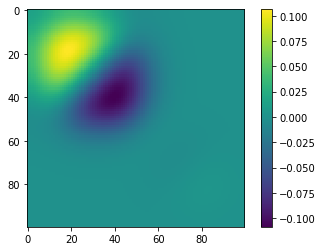

In [13]:
plt.imshow(x_comp_sim[28]+y_comp_sim[28])
plt.colorbar()

In [14]:
out = np.zeros(tensor.shape)

In [64]:
from IPython.display import HTML
HTML(ani_sim)

In [65]:
import numpy as np
import matplotlib.pyplot as plt

def plot_array_as_contour(array, fig = None, ax = None, figsize=(10,10)):
    if not fig:
        fig, ax = plt.subplots(1,figsize=figsize)
    ax.cla()
    xlist = np.arange(0,array.shape[1])
    ylist = np.arange(0,array.shape[0])
    X, Y = np.meshgrid(xlist, ylist)
    cp = ax.contourf(X, Y, array, vmin=0,vmax=1, levels=int(np.max(array)*10))
    #plt.show()
    return fig, ax

In [66]:
%%capture
fig, ax = plot_array_as_contour(tensor[0])
frames = 40

def animate(array, fig, ax):
    print(".", end ="")    
    plot_array_as_contour(array, fig=fig, ax=ax)

ani_sim = matplotlib.animation.FuncAnimation(fig, lambda x: animate(tensor[x], fig, ax), frames=frames)

In [67]:
HTML(ani_sim.to_jshtml())

.........................................

# Boolean arrays from grayscale

In [72]:
tensor = normalize(tensor)

In [75]:
tensor.shape

(80, 100, 100)

In [80]:
def grayscale_to_booleans(array, bins=10):
    output = np.ndarray((bins, array.shape[0],array.shape[1]))
    for i in range(0,bins):
        output[i,:,:] = array >= (i+1)/(bins+1)
    return output

In [81]:
%%capture
ani = show_video(grayscale_to_booleans(tensor[5]),grayscale_to_booleans(tensor[6]), n_frames =10)

In [82]:
HTML(ani)

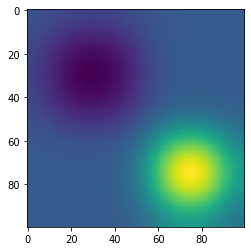

In [83]:
plt.imshow(tensor[49]-tensor[48])

In [84]:
from scipy.ndimage import label, generate_binary_structure

In [85]:
from scipy.ndimage.morphology import distance_transform_cdt
from scipy.ndimage.morphology import distance_transform_edt

In [86]:
source = grayscale_to_booleans(tensor[5])
target = grayscale_to_booleans(tensor[6])

labeled_source, n_features_source = label(source)#3d tensor
labeled_target, n_features_target = label(target)

In [87]:
def plot_gradient_field(source, target):
    padding = np.max(list(source.shape))//2
    
    source_outline = source-binary_erosion(source)
    bg = source_outline.copy().astype(np.int32)
    bg += target == 0
    
    target = np.pad(target, padding)
    
    dist = distance_transform_edt(target==0)
    dist1 = distance_transform_edt(target==1)
    dist[target>0] = dist1[target>0]
    dist = dist[padding:-padding, padding:-padding]

    fig, ax = plt.subplots(1, figsize=(10,10))
    y_comp, x_comp = np.gradient(dist,2)
    display_combined(-y_comp, -x_comp, bg, fig=fig, ax=ax, scale=2)
    plt.show()

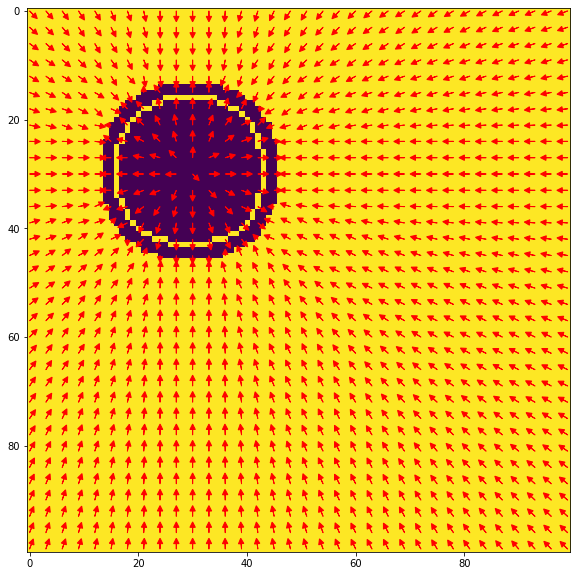

In [88]:
plot_gradient_field(labeled_source[2][:,:], labeled_target[2][:,:])

In [ ]:
y_comp, x_comp = array_to_vector_field(labeled_source[2], labeled_target[2], stepsize=.5)

In [ ]:
idx = 0

y_comp, x_comp = array_to_vector_field(labeled_source[idx], labeled_target[idx], stepsize=1)
bg = labeled_source[idx]-binary_erosion(labeled_source[idx])
bg += labeled_target[idx]-binary_erosion(labeled_target[idx])
print(bg.shape)

fig, ax = plt.subplots(1, figsize=(10,10))
display_combined(y_comp, x_comp, bg, fig=fig, ax=ax, scale=1, quivstep=1)
plt.show()

In [90]:
def array_to_vector_field(source, target, vec_y = None, vec_x = None, stepsize=.5, smooth=1):
    if type(vec_y) ==  type(None):
        vec_y = np.zeros(source.shape)
        vec_y.fill(np.nan)
    if type(vec_x) == type(None):
        vec_x = np.zeros(target.shape)
        vec_x.fill(np.nan)
    padding = np.max(list(source.shape))//2
    
    source_outline = source.astype(np.int32) - binary_erosion(source).astype(np.int32)
    target_outline = target.astype(np.int32)-binary_erosion(target).astype(np.int32)

    not_target = target == 0
    not_target = np.logical_or(not_target,target_outline)
    
    target = np.pad(target, padding)
    
    dist = distance_transform_edt(target==0)
    dist1 = distance_transform_edt(target==1)
    dist[target>0] = dist1[target>0]
    dist = dist[padding:-padding, padding:-padding]
    grad_y, grad_x = np.gradient(dist,2)

    for y_start, x_start in np.array(np.where(source_outline)).T:
        y = y_start
        x = x_start

        iteration = 0
        while(True):
            #print(y_comp[int(y),int(x)], end= " ")
            #print(x_comp[int(y),int(x)])
            #print(str(y) + " " + str(x))
            
            y -= grad_y[int(round(y)),int(round(x))]*stepsize*2
            x -= grad_x[int(round(y)),int(round(x))]*stepsize*2
            
            if not_target[int(round(y)),int(round(x))]:
                vec_y[y_start, x_start] = y_start-y
                vec_x[y_start, x_start] = x_start-x                    
                break
            
            """print(y, end=" ")
            print(x)
            if not_target[int(round(y)),int(round(x))]:
                img[int(y), int(x)] = 10
                plt.imshow(img)
                plt.show()
                break"""
            
    if smooth:
        vec_y = smoothen_sparse_array(vec_y, 1)
        vec_x = smoothen_sparse_array(vec_x, 1)

    return -vec_y, -vec_x


def smoothen_sparse_array(array, size=3, proportion=1):
    new = np.ndarray(array.shape)
    new.fill(np.nan)
    for y, x in np.array(np.where(~np.isnan(array))).T:
        snippet = array[y-size  :y+size+1,
                        x-size-1:x+size]
        new_val = np.nanmean(snippet)
        new[y,x] = (proportion * new_val) + (1 - proportion) * array[y,x]
    return new


def levelsets_to_vector_field(levelsets):
    """ Take levelsets and compute vector field
    Args:
        source: array of labels
        target: array of labels
    """
    vector_field_shape = levelsets[0][0].shape
    y_comp_combined = np.ndarray(vector_field_shape)
    x_comp_combined = np.ndarray(vector_field_shape)
    y_comp_combined.fill(np.nan)
    x_comp_combined.fill(np.nan)

    for source, target in levelsets:
        labels_present = set(np.array([source.flatten(),target.flatten()]).flatten())
        labels_present.remove(0)#relates to background
        for l in labels_present:
            
            """plt.imshow(source)
            plt.colorbar()
            plt.show()"""
            source_cluster = source == l
            target_cluster = target == l
            
            try:
                y0 = int(np.mean(np.where(np.mean(source_cluster, axis=0))))
                x0 = int(np.mean(np.where(np.mean(source_cluster, axis=1))))
                y1 = int(np.mean(np.where(np.mean(target_cluster, axis=0))))
                x1 = int(np.mean(np.where(np.mean(target_cluster, axis=1))))
            except ValueError:
                pass
                continue

            # Determine shift to move target cluster to center of gravity of source cluster
            x_shift = np.abs(y0-y1)
            y_shift = np.abs(x0-x1)

            #Pad source cluster, shift pixels in target to desired location
            padding = np.max(list(source_cluster.shape))//2        
            source_cluster = np.pad(source_cluster, padding)
            new_target_cluster = np.zeros(source_cluster.shape)
            new_target_cluster[padding+y_shift:padding+target_cluster.shape[0]+y_shift, 
                               padding+x_shift:padding+target_cluster.shape[1]+x_shift] = target_cluster
            target_cluster = new_target_cluster
            
            """plt.imshow(target_cluster)
            plt.show()

            plt.imshow(source_cluster)
            plt.show()
            print("-----------")"""

            y_comp, x_comp = array_to_vector_field(source_cluster, target_cluster, stepsize=1)
            y_comp = y_comp[padding:-padding,padding:-padding]
            x_comp = x_comp[padding:-padding,padding:-padding]

            y_comp_combined[~np.isnan(y_comp)] = y_comp[~np.isnan(y_comp)]-x_shift
            x_comp_combined[~np.isnan(x_comp)] = x_comp[~np.isnan(x_comp)]-y_shift
    return y_comp_combined, x_comp_combined


def levelset_flow(x, n_scales=5):

    y_comps = []
    x_comps = []
    levelsets = []
    for frame1, frame2 in zip(x, x[1:]):
        levelset_source = grayscale_to_booleans(frame1, n_scales)
        levelset_target = grayscale_to_booleans(frame2, n_scales)
        
        print(levelset_source.shape)
        paired = np.array([np.array([levelset1,levelset2]) for levelset1, levelset2 in zip(levelset_source,levelset_target)])
        labeled = np.array([label(x)[0] for x in paired])
        #print(paired.shape)
        #print(labeled.shape)

        y_comp, x_comp = levelsets_to_vector_field(labeled)
        y_comps.append(y_comp)
        x_comps.append(x_comp)
        levelsets.append(np.mean(levelset_source, axis=0))
    return np.array(y_comps), np.array(x_comps), np.array(levelsets)
    #y_comp, x_comp = levelsets_to_vector_field(source, target)

In [48]:
y_comp, x_comp, bg = levelset_flow(tensor[1:7])

(5, 100, 100)
(5, 100, 100)
(5, 100, 100)
(5, 100, 100)
(5, 100, 100)


(<Figure size 720x720 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7fca6bdaced0>)

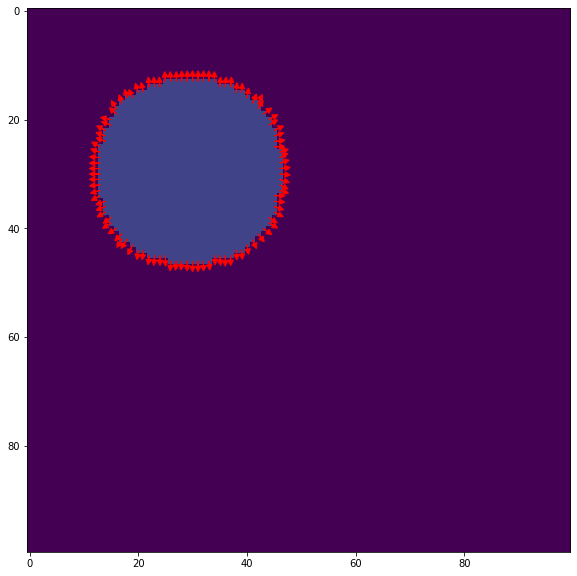

In [347]:
display_combined(y_comp[0], x_comp[0], bg[0], quivstep=1, scale=1)

In [348]:
tensor[50:].shape

(30, 100, 100)

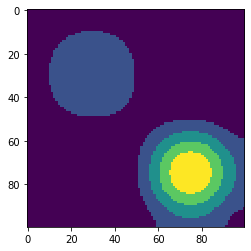

In [349]:
plt.imshow(grayscale_to_booleans(tensor[39], 10).mean(axis=0))

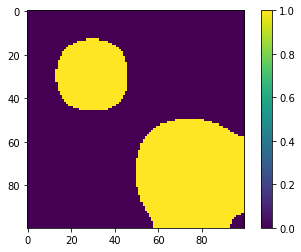

In [350]:
plt.imshow(grayscale_to_booleans(tensor[40], bins=10)[0])
plt.colorbar()

Label every pair of subsequent frames.... TODO

In [ ]:
y_comps, x_comps, bgs = levelset_flow(tensor, n_scales=12)#tensor[30:40:])

In [364]:
y_comps.shape

(79, 100, 100)

In [93]:
%%capture
fig_sim, ax_sim = display_combined(y_comps[0],x_comps[0], bgs[0])
frames = len(y_comps)

def animate(i):
    print(".", end ="")    
    display_combined(y_comps[i],x_comps[i], bgs[i], fig=fig_sim, ax=ax_sim, quivstep=1, scale=1)

ani_sim = matplotlib.animation.FuncAnimation(fig_sim, animate, frames=frames).to_jshtml()

In [94]:
HTML(ani_sim)

# Conclustion

Dense optical flow is different from motion detection which becomes visible here. Some patterns in dense optical flow (e.g. saddles) arguably relate to a local peak in activation that occurs at a specific location. If one applies dense optical flow on the neural signals with peaks that do not move but increase/decrease in intensity this is what one will arguably capture when transforming the signal using e.g. Horn and Schuncks method and detecting motion patterns.